# Analysing Brazillian Ecommerce Public Dataset by Olist (2016- 2018)

_This is a notebook by Ibrahim Ogunbiyi_

Analysis of Brazilian E-Commerce Public Dataset by Olist

Acknoledgement: Thanks to Olist for Providing this Dataset.

## Inspiration On this DataSet

This dataset is massive and contains numerous insights. This dataset's analysis will be based on customer segmentation via product categories. I'll create a clustering model to help segment customers based on a specific set of products using the customer's behavior (such as location, etc.) from the dataset.

## Dataset Schema
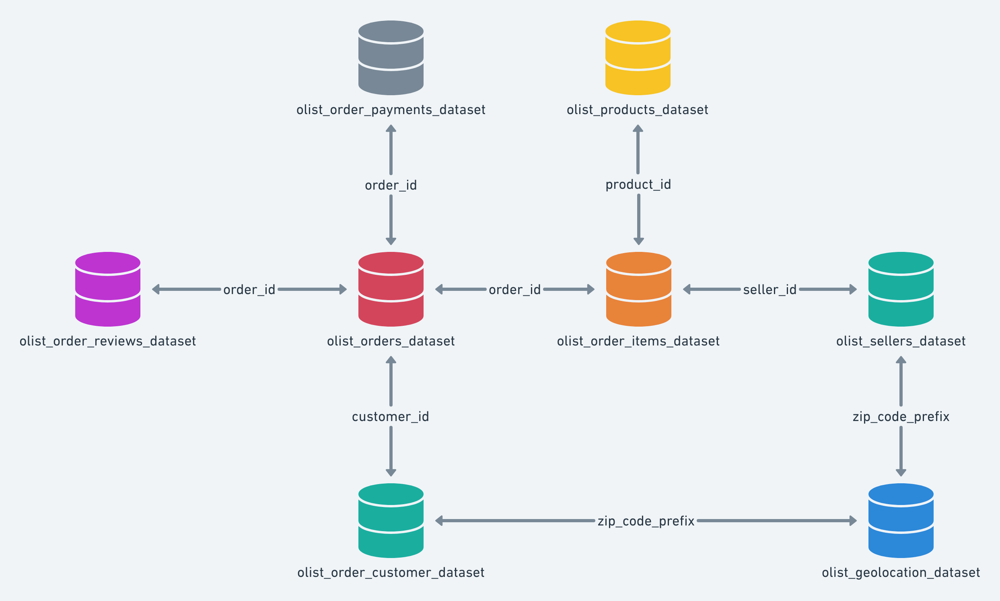


# Merging the Dataset all together.

In [1]:
#Import Wrangling and visualization library

import pandas as pd
import numpy as np
import seaborn as sns
import plotly.express as px
from matplotlib import pyplot as plt

First loading the customer dataset in a dataframe.

In [2]:
customer_df = pd.read_csv("data/olist_customers_dataset.csv")
customer_df.head()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP


The first thing I wanna do is merge the customer dataset with the geolocation dataset, so that I visualize precisely where each customers lives in the dataset. I am going to merge it on the zip_code variable.

### Merging the Customer and Geo-Location Dataset.

In [3]:
geo_df = pd.read_csv("data/olist_geolocation_dataset.csv")
geo_df["geolocation_zip_code_prefix"].nunique()

19015

The zip_code name on both dataset does not match I will have to rename the one in the customer dataset. so it corresponds to the one on the geolocation dataset.

In [4]:
geo_df.head()

,geolocation_zip_code_prefix,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
0,1037,-23.545621,-46.639292,sao paulo,SP
1,1046,-23.546081,-46.644820,sao paulo,SP
2,1046,-23.546129,-46.642951,sao paulo,SP
3,1041,-23.544392,-46.639499,sao paulo,SP
4,1035,-23.541578,-46.641607,sao paulo,SP


In [5]:
customer_df.head()

,customer_id,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP


In [6]:
customer_df.rename(columns = {"customer_zip_code_prefix": "geolocation_zip_code_prefix"}, inplace=True)

The geo_location dataframe has some duplicates values so we need to derop them before the merging.

In [7]:
geo_df = geo_df.drop_duplicates(subset=["geolocation_zip_code_prefix"])

In [8]:
full_df = pd.merge(customer_df, geo_df, on="geolocation_zip_code_prefix", how="left")
full_df.head()

,customer_id,customer_unique_id,geolocation_zip_code_prefix,customer_city,customer_state,geolocation_lat,geolocation_lng,geolocation_city,geolocation_state
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,-20.509897,-47.397866,franca,SP
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP,-23.726853,-46.545746,sao bernardo do campo,SP
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP,-23.527788,-46.660310,sao paulo,SP
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP,-23.496930,-46.185352,mogi das cruzes,SP
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,-22.987222,-47.151073,campinas,SP


In [9]:
full_df.shape

(99441, 9)

We need to remove some duplicate features, such as customer state and geolocation state, and customer city and geolocation city. Geolocation state and geolocation city will be removed.

The above summary made us know that there are some observations in the customer ID that their zip code is not found in the geolocation dataset. About 250 of them are not in the geolocation dataset.

In [10]:
full_df.drop(columns = ["geolocation_state", "geolocation_city"], inplace=True)

### Merging the Full Dataset with Order Dataset

The next thing I wanna do is merge the full dataset and the order dataset. I will need to merge both dataset on thier customer ID (the ID given to each customer when they order for a particular product).

First I need to read the order dataset into a dataframe.

In [11]:
order_df = pd.read_csv("data/olist_orders_dataset.csv")
order_df.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00


Let's delete some features we won't be using in the dataset.

In [12]:
order_df.isna().sum()

order_id                            0
customer_id                         0
order_status                        0
order_purchase_timestamp            0
order_approved_at                 160
order_delivered_carrier_date     1783
order_delivered_customer_date    2965
order_estimated_delivery_date       0
dtype: int64

In [13]:
order_df.drop(columns = ["order_status", "order_approved_at",
                         "order_delivered_carrier_date", "order_delivered_customer_date",
                        "order_estimated_delivery_date"], inplace=True)

The reason why we didn't drop the order purchase time stamp is because there could be a trend as to when some people in a particular state do order for some certain set of goods.

In [14]:
full_df = pd.merge(full_df, order_df, on = "customer_id")
full_df.head()

,customer_id,customer_unique_id,geolocation_zip_code_prefix,customer_city,customer_state,geolocation_lat,geolocation_lng,order_id,order_purchase_timestamp
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,-20.509897,-47.397866,00e7ee1b050b8499577073aeb2a297a1,2017-05-16 15:05:35
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP,-23.726853,-46.545746,29150127e6685892b6eab3eec79f59c7,2018-01-12 20:48:24
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP,-23.527788,-46.660310,b2059ed67ce144a36e2aa97d2c9e9ad2,2018-05-19 16:07:45
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP,-23.496930,-46.185352,951670f92359f4fe4a63112aa7306eba,2018-03-13 16:06:38
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,-22.987222,-47.151073,6b7d50bd145f6fc7f33cebabd7e49d0f,2018-07-29 09:51:30


In [15]:
full_df.shape

(99441, 9)

### Merging the Full Dataset with the Order Payment ID

In [16]:
payment_df = pd.read_csv("data/olist_order_payments_dataset.csv")
print(payment_df.shape)
payment_df.head()

(103886, 5)


,order_id,payment_sequential,payment_type,payment_installments,payment_value
0,b81ef226f3fe1789b1e8b2acac839d17,1,credit_card,8,99.33
1,a9810da82917af2d9aefd1278f1dcfa0,1,credit_card,1,24.39
2,25e8ea4e93396b6fa0d3dd708e76c1bd,1,credit_card,1,65.71
3,ba78997921bbcdc1373bb41e913ab953,1,credit_card,8,107.78
4,42fdf880ba16b47b59251dd489d4441a,1,credit_card,2,128.45


Let's drop the payment value for each product.

In [17]:
payment_df.drop(columns = ["payment_value"], inplace=True)

In [18]:
full_df = pd.merge(full_df, payment_df, on = "order_id")
print(full_df.shape)
full_df.head()

(103886, 12)


,customer_id,customer_unique_id,geolocation_zip_code_prefix,customer_city,customer_state,geolocation_lat,geolocation_lng,order_id,order_purchase_timestamp,payment_sequential,payment_type,payment_installments
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,-20.509897,-47.397866,00e7ee1b050b8499577073aeb2a297a1,2017-05-16 15:05:35,1,credit_card,2
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP,-23.726853,-46.545746,29150127e6685892b6eab3eec79f59c7,2018-01-12 20:48:24,1,credit_card,8
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP,-23.527788,-46.660310,b2059ed67ce144a36e2aa97d2c9e9ad2,2018-05-19 16:07:45,1,credit_card,7
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP,-23.496930,-46.185352,951670f92359f4fe4a63112aa7306eba,2018-03-13 16:06:38,1,credit_card,1
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,-22.987222,-47.151073,6b7d50bd145f6fc7f33cebabd7e49d0f,2018-07-29 09:51:30,1,credit_card,8


### Merging the Full Dataset with the Order Item

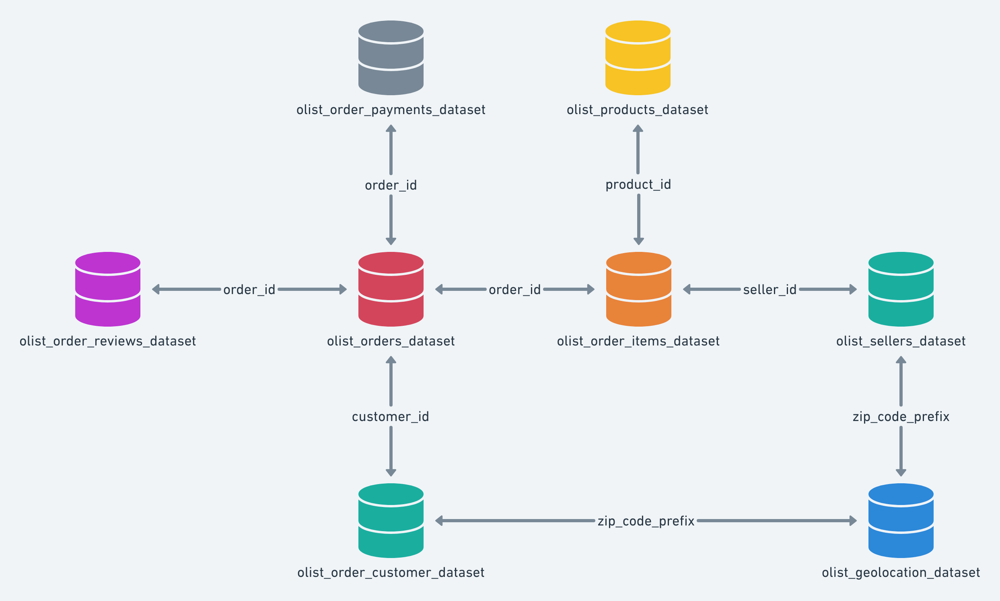

In [19]:
order_item_df = pd.read_csv("data/olist_order_items_dataset.csv")
print(order_item_df.shape)
order_item_df.head()

(112650, 7)


,order_id,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value
0,00010242fe8c5a6d1ba2dd792cb16214,1,4244733e06e7ecb4970a6e2683c13e61,48436dade18ac8b2bce089ec2a041202,2017-09-19 09:45:35,58.90,13.29
1,00018f77f2f0320c557190d7a144bdd3,1,e5f2d52b802189ee658865ca93d83a8f,dd7ddc04e1b6c2c614352b383efe2d36,2017-05-03 11:05:13,239.90,19.93
2,000229ec398224ef6ca0657da4fc703e,1,c777355d18b72b67abbeef9df44fd0fd,5b51032eddd242adc84c38acab88f23d,2018-01-18 14:48:30,199.00,17.87
3,00024acbcdf0a6daa1e931b038114c75,1,7634da152a4610f1595efa32f14722fc,9d7a1d34a5052409006425275ba1c2b4,2018-08-15 10:10:18,12.99,12.79
4,00042b26cf59d7ce69dfabb4e55b4fd9,1,ac6c3623068f30de03045865e4e10089,df560393f3a51e74553ab94004ba5c87,2017-02-13 13:57:51,199.90,18.14


Let's drop some features we won't need in the above dataset.

In [20]:
order_item_df.drop(columns = ["freight_value", "shipping_limit_date"], inplace=True)

In [21]:
full_df = pd.merge(full_df, order_item_df, on = "order_id")
print(full_df.shape)
full_df.head()

(117601, 16)


,customer_id,customer_unique_id,geolocation_zip_code_prefix,customer_city,customer_state,geolocation_lat,geolocation_lng,order_id,order_purchase_timestamp,payment_sequential,payment_type,payment_installments,order_item_id,product_id,seller_id,price
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,-20.509897,-47.397866,00e7ee1b050b8499577073aeb2a297a1,2017-05-16 15:05:35,1,credit_card,2,1,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,124.99
1,18955e83d337fd6b2def6b18a428ac77,290c77bc529b7ac935b93aa66c333dc3,9790,sao bernardo do campo,SP,-23.726853,-46.545746,29150127e6685892b6eab3eec79f59c7,2018-01-12 20:48:24,1,credit_card,8,1,4aa6014eceb682077f9dc4bffebc05b0,b8bc237ba3788b23da09c0f1f3a3288c,289.00
2,4e7b3e00288586ebd08712fdd0374a03,060e732b5b29e8181a18229c7b0b2b5e,1151,sao paulo,SP,-23.527788,-46.660310,b2059ed67ce144a36e2aa97d2c9e9ad2,2018-05-19 16:07:45,1,credit_card,7,1,bd07b66896d6f1494f5b86251848ced7,7c67e1448b00f6e969d365cea6b010ab,139.94
3,b2b6027bc5c5109e529d4dc6358b12c3,259dac757896d24d7702b9acbbff3f3c,8775,mogi das cruzes,SP,-23.496930,-46.185352,951670f92359f4fe4a63112aa7306eba,2018-03-13 16:06:38,1,credit_card,1,1,a5647c44af977b148e0a3a4751a09e2e,7c67e1448b00f6e969d365cea6b010ab,149.94
4,4f2d8ab171c80ec8364f7c12e35b23ad,345ecd01c38d18a9036ed96c73b8d066,13056,campinas,SP,-22.987222,-47.151073,6b7d50bd145f6fc7f33cebabd7e49d0f,2018-07-29 09:51:30,1,credit_card,8,1,9391a573abe00141c56e38d84d7d5b3b,4a3ca9315b744ce9f8e9374361493884,230.00


### Merging the Full Dataset with the Product Dataset

In [22]:
product_df = pd.read_csv("data/olist_products_dataset.csv")
print(product_df.shape)
product_df.head()

(32951, 9)


,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumaria,40.0,287.0,1.0,225.0,16.0,10.0,14.0
1,3aa071139cb16b67ca9e5dea641aaa2f,artes,44.0,276.0,1.0,1000.0,30.0,18.0,20.0
2,96bd76ec8810374ed1b65e291975717f,esporte_lazer,46.0,250.0,1.0,154.0,18.0,9.0,15.0
3,cef67bcfe19066a932b7673e239eb23d,bebes,27.0,261.0,1.0,371.0,26.0,4.0,26.0
4,9dc1a7de274444849c219cff195d0b71,utilidades_domesticas,37.0,402.0,4.0,625.0,20.0,17.0,13.0


In [23]:
product_df["product_category_name"].nunique()

73

The product name are in brazilian we need to translate it to it english variant. Luckily for us we have the dataset that can help us achieve that.

In [24]:
product_name = pd.read_csv("data/product_category_name_translation.csv")

In [25]:
key = product_name["product_category_name"].tolist()
value = product_name["product_category_name_english"].tolist()

In [26]:
product_df["product_category_name"].replace(to_replace=key, value=value, inplace=True)

In [27]:
product_df.head()

,product_id,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
0,1e9e8ef04dbcff4541ed26657ea517e5,perfumery,40.0,287.0,1.0,225.0,16.0,10.0,14.0
1,3aa071139cb16b67ca9e5dea641aaa2f,art,44.0,276.0,1.0,1000.0,30.0,18.0,20.0
2,96bd76ec8810374ed1b65e291975717f,sports_leisure,46.0,250.0,1.0,154.0,18.0,9.0,15.0
3,cef67bcfe19066a932b7673e239eb23d,baby,27.0,261.0,1.0,371.0,26.0,4.0,26.0
4,9dc1a7de274444849c219cff195d0b71,housewares,37.0,402.0,4.0,625.0,20.0,17.0,13.0


Let's drop some features we won't be needing in this dataset.

In [28]:
product_df.drop(columns = ["product_name_lenght", "product_description_lenght",
                           "product_photos_qty", "product_weight_g",
                          "product_length_cm", "product_height_cm", "product_width_cm"], inplace=True)

Now let's do the merging

In [29]:
full_df = pd.merge(full_df, product_df, on = "product_id")
print(full_df.shape)
full_df.head()

(117601, 17)


,customer_id,customer_unique_id,geolocation_zip_code_prefix,customer_city,customer_state,geolocation_lat,geolocation_lng,order_id,order_purchase_timestamp,payment_sequential,payment_type,payment_installments,order_item_id,product_id,seller_id,price,product_category_name
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,-20.509897,-47.397866,00e7ee1b050b8499577073aeb2a297a1,2017-05-16 15:05:35,1,credit_card,2,1,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,124.99,office_furniture
1,8912fc0c3bbf1e2fbf35819e21706718,9eae34bbd3a474ec5d07949ca7de67c0,68030,santarem,PA,-2.442747,-54.728950,c1d2b34febe9cd269e378117d6681172,2017-11-09 00:50:13,1,credit_card,1,1,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,112.99,office_furniture
2,8912fc0c3bbf1e2fbf35819e21706718,9eae34bbd3a474ec5d07949ca7de67c0,68030,santarem,PA,-2.442747,-54.728950,c1d2b34febe9cd269e378117d6681172,2017-11-09 00:50:13,1,credit_card,1,2,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,112.99,office_furniture
3,f0ac8e5a239118859b1734e1087cbb1f,3c799d181c34d51f6d44bbbc563024db,92480,nova santa rita,RS,-29.856534,-51.268958,b1a5d5365d330d10485e0203d54ab9e8,2017-05-07 20:11:26,1,credit_card,7,1,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,124.99,office_furniture
4,6bc8d08963a135220ed6c6d098831f84,23397e992b09769faf5e66f9e171a241,25931,mage,RJ,-22.627556,-43.159942,2e604b3614664aa66867856dba7e61b7,2018-02-03 19:45:40,1,credit_card,10,1,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,106.99,office_furniture


# Exploratory Data Analysis (EDA)

In [30]:
full_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 117601 entries, 0 to 117600
Data columns (total 17 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   customer_id                  117601 non-null  object 
 1   customer_unique_id           117601 non-null  object 
 2   geolocation_zip_code_prefix  117601 non-null  int64  
 3   customer_city                117601 non-null  object 
 4   customer_state               117601 non-null  object 
 5   geolocation_lat              117289 non-null  float64
 6   geolocation_lng              117289 non-null  float64
 7   order_id                     117601 non-null  object 
 8   order_purchase_timestamp     117601 non-null  object 
 9   payment_sequential           117601 non-null  int64  
 10  payment_type                 117601 non-null  object 
 11  payment_installments         117601 non-null  int64  
 12  order_item_id                117601 non-null  int64  
 13 

From the above summary we can see that there are some missing values in this dataset. Now let's explore some features in the dataset to know the behaviour of our customers.

## Location of Customers (State)

Let's look at how clustered how customers is in Brazil. I.e. let's summarize where most of our customer states is in brazil.

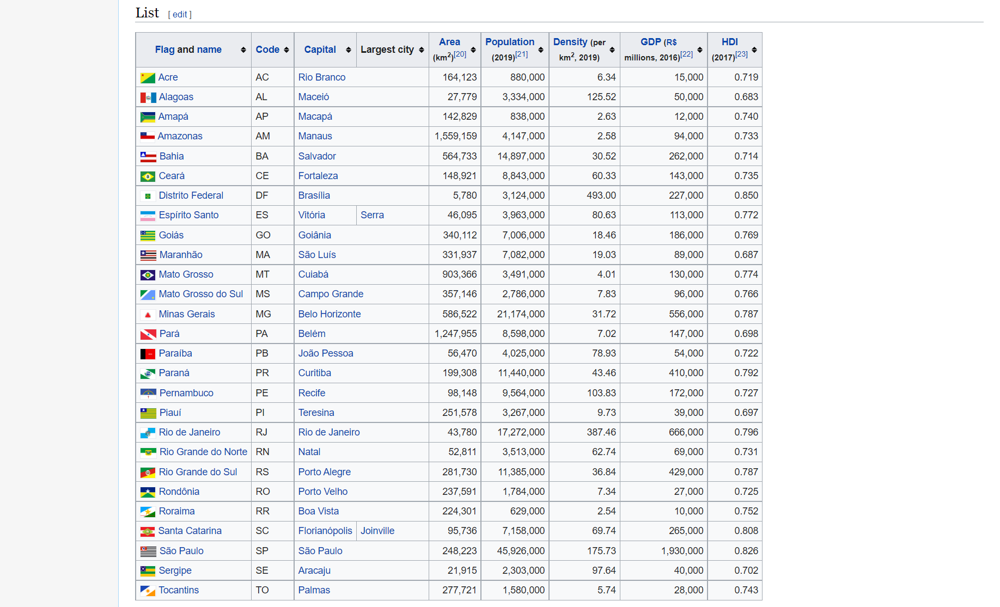

In [31]:
full_df["customer_state"].value_counts(normalize=True).head(10)

SP    0.421476
RJ    0.130331
MG    0.115968
RS    0.055153
PR    0.050697
SC    0.036581
BA    0.034421
DF    0.021029
GO    0.020663
ES    0.019881
Name: customer_state, dtype: float64

We can see from the above summary that  approximately 42% of our customers lives in **Sao Paulo** which is followed by approximately 13 person of them who live in **Rio de Janeiro**. Let's visualize the summary so we can obtain a more sense from it. 

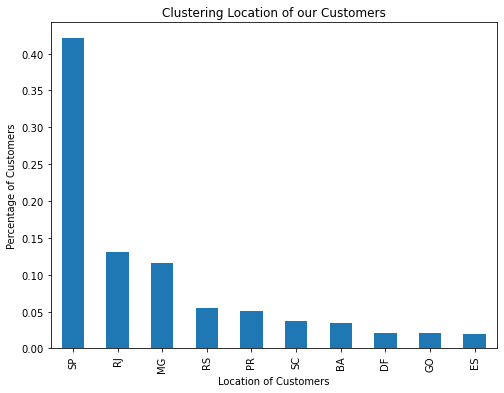

In [32]:
fig, ax = plt.subplots(figsize=(8, 6))
full_df["customer_state"].value_counts(normalize=True).head(10).plot.bar()
plt.xlabel("Location of Customers")
plt.ylabel("Percentage of Customers")
plt.title("Clustering Location of our Customers");

## Numbers of Unique Customers

In [33]:
full_df["customer_unique_id"].nunique()

95419

We have 95419 unique customers in this dataset. I.e. we have customers who has made an order more than one time.

## Customer City

Let's look at the top ten cities our customers are clustered.

In [34]:
full_df["customer_city"].nunique()

4110

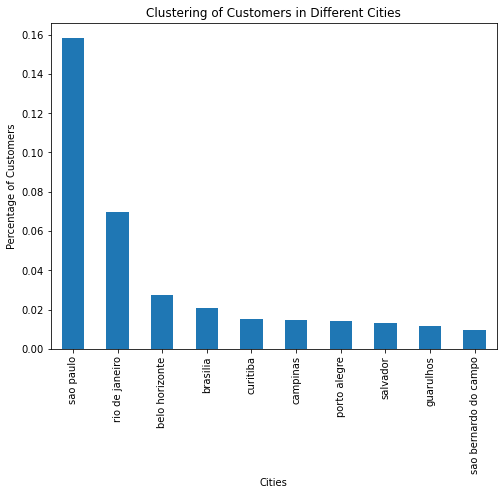

In [35]:
fig, ax = plt.subplots(figsize=(8, 6))
full_df["customer_city"].value_counts(normalize=True).head(10).plot.bar()
plt.xlabel("Cities")
plt.ylabel("Percentage of Customers")
plt.title("Clustering of Customers in Different Cities");

We can see also from the above summary that close to 16% of customers lives at **Sau Paulo**, etc.

In [36]:
full_df.head()

,customer_id,customer_unique_id,geolocation_zip_code_prefix,customer_city,customer_state,geolocation_lat,geolocation_lng,order_id,order_purchase_timestamp,payment_sequential,payment_type,payment_installments,order_item_id,product_id,seller_id,price,product_category_name
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,-20.509897,-47.397866,00e7ee1b050b8499577073aeb2a297a1,2017-05-16 15:05:35,1,credit_card,2,1,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,124.99,office_furniture
1,8912fc0c3bbf1e2fbf35819e21706718,9eae34bbd3a474ec5d07949ca7de67c0,68030,santarem,PA,-2.442747,-54.728950,c1d2b34febe9cd269e378117d6681172,2017-11-09 00:50:13,1,credit_card,1,1,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,112.99,office_furniture
2,8912fc0c3bbf1e2fbf35819e21706718,9eae34bbd3a474ec5d07949ca7de67c0,68030,santarem,PA,-2.442747,-54.728950,c1d2b34febe9cd269e378117d6681172,2017-11-09 00:50:13,1,credit_card,1,2,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,112.99,office_furniture
3,f0ac8e5a239118859b1734e1087cbb1f,3c799d181c34d51f6d44bbbc563024db,92480,nova santa rita,RS,-29.856534,-51.268958,b1a5d5365d330d10485e0203d54ab9e8,2017-05-07 20:11:26,1,credit_card,7,1,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,124.99,office_furniture
4,6bc8d08963a135220ed6c6d098831f84,23397e992b09769faf5e66f9e171a241,25931,mage,RJ,-22.627556,-43.159942,2e604b3614664aa66867856dba7e61b7,2018-02-03 19:45:40,1,credit_card,10,1,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,106.99,office_furniture


## Customer Exact Location 

Let's visualize the exact customer location using plotly express

In [37]:
full_df.iloc[:, :10]

,customer_id,customer_unique_id,geolocation_zip_code_prefix,customer_city,customer_state,geolocation_lat,geolocation_lng,order_id,order_purchase_timestamp,payment_sequential
0,06b8999e2fba1a1fbc88172c00ba8bc7,861eff4711a542e4b93843c6dd7febb0,14409,franca,SP,-20.509897,-47.397866,00e7ee1b050b8499577073aeb2a297a1,2017-05-16 15:05:35,1
1,8912fc0c3bbf1e2fbf35819e21706718,9eae34bbd3a474ec5d07949ca7de67c0,68030,santarem,PA,-2.442747,-54.728950,c1d2b34febe9cd269e378117d6681172,2017-11-09 00:50:13,1
2,8912fc0c3bbf1e2fbf35819e21706718,9eae34bbd3a474ec5d07949ca7de67c0,68030,santarem,PA,-2.442747,-54.728950,c1d2b34febe9cd269e378117d6681172,2017-11-09 00:50:13,1
3,f0ac8e5a239118859b1734e1087cbb1f,3c799d181c34d51f6d44bbbc563024db,92480,nova santa rita,RS,-29.856534,-51.268958,b1a5d5365d330d10485e0203d54ab9e8,2017-05-07 20:11:26,1
4,6bc8d08963a135220ed6c6d098831f84,23397e992b09769faf5e66f9e171a241,25931,mage,RJ,-22.627556,-43.159942,2e604b3614664aa66867856dba7e61b7,2018-02-03 19:45:40,1
...,...,...,...,...,...,...,...,...,...,...
117596,da37711b17efd5f2539e8196ab215f04,5f2971f9805e3ccb030226e30c8e8390,4313,sao paulo,SP,-23.635804,-46.638032,c8203bb57639618630affac9e8e923dd,2017-03-27 23:04:18,1
117597,184e0c2cfc746789643521df0e9ff904,c64ede6d0ae8901b1b6fb03528c1b7e6,68660,sao miguel do guama,PA,-1.622386,-47.476586,45b3000bcd10464ac178f32cd783fc83,2017-12-07 23:55:46,1
117598,821a7275a08f32975caceff2e08ea262,046470763123d3d6364f89095b4e47ab,5734,sao paulo,SP,-23.626153,-46.746920,49645a8902c1ba980836b7bff991d69f,2018-04-04 17:50:52,1
117599,1ed0c832c2dd99570a59260e71768bdf,82d46759af0369aad49084bacf85a6c3,37610,bom repouso,MG,-22.469555,-46.147500,51c6d2f460589fa7b65f2da51e860206,2017-11-14 12:04:09,1


We want to build a map based on customer's coordinate, but as well we want to center the map in the middle of brazil. So we can leverage the geopy.geocoder app.

In [38]:
from geopy.geocoders import Nominatim # Convert Adress into coordinates

address = 'Brazil' #The adress we want to retrieve

geolocator = Nominatim(user_agent="brazil_explorer") # user agent. You can use any name
location = geolocator.geocode(address)

center_lat = location.latitude # store longitude value
center_lon = location.longitude # store latitude value

print(center_lat,center_lon )

-10.3333333 -53.2


In [39]:
access = "pk.eyJ1IjoiZm9sa3Njb25uZWN0IiwiYSI6ImNsMDNuMTFmZDBpZm0zbHFiNDRmamM4ZjUifQ.0JtAC9vffEeZg8z4f_4kTQ"

In [40]:
fig = px.scatter_mapbox(
    data_frame=full_df,
    lat = "geolocation_lat",
    lon = "geolocation_lng",
    hover_name = "customer_city",
    height = 800,
    width = 1000,
    zoom=5,
    color_discrete_sequence= ["orange"],
    title = "Customer Exact Location Visualization",
    center={
        "lat" : center_lat,
        "lon" : center_lon
    }
    
)
fig.update_layout(mapbox_style ="streets",
                 mapbox = dict(accesstoken=access))

fig.show()

We can see visually that most of the customers lives in the south east of brazil. Also interesting to see that we have customers who orders from Uruguay, Argentina and portugal.

In [41]:
full_df.head().iloc[:, 9:]

,payment_sequential,payment_type,payment_installments,order_item_id,product_id,seller_id,price,product_category_name
0,1,credit_card,2,1,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,124.99,office_furniture
1,1,credit_card,1,1,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,112.99,office_furniture
2,1,credit_card,1,2,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,112.99,office_furniture
3,1,credit_card,7,1,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,124.99,office_furniture
4,1,credit_card,10,1,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,106.99,office_furniture


## Order Id

In [42]:
full_df["order_id"].nunique()

98665

From this dataset we have 98665 unique id'es. Let's check the value counts for each ids

In [43]:
full_df["order_id"].value_counts().head(10)

895ab968e7bb0d5659d16cd74cd1650c    63
fedcd9f7ccdc8cba3a18defedd1a5547    38
fa65dad1b0e818e3ccc5cb0e39231352    29
ccf804e764ed5650cd8759557269dc13    26
68986e4324f6a21481df4e6e89abcf01    24
c6492b842ac190db807c15aff21a7dd6    24
a3725dfe487d359b5be08cac48b64ec5    24
465c2e1bee4561cb39e0db8c5993aafc    24
285c2e15bebd4ac83635ccc563dc71f4    22
1c11d0f4353b31ac3417fbfa5f0f2a8a    21
Name: order_id, dtype: int64

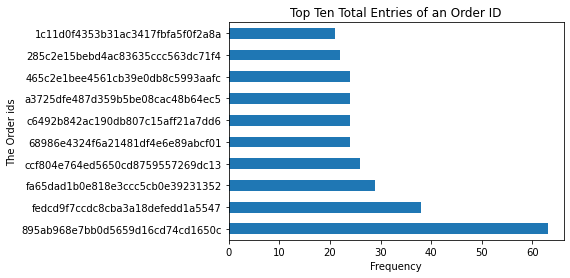

In [44]:
full_df["order_id"].value_counts().head(10).plot.barh()
plt.title("Top Ten Total Entries of an Order ID")
plt.ylabel("The Order ids")
plt.xlabel("Frequency");

We can see that the order id "895ab968e7bb0d5659d16cd74cd1650c" has 60 number of entries. This could be caused by any factor such as installment or etc.

## Order Purchase Time Stamp

#### Convert it to a datetime object

In [45]:
#import the datetime object
from datetime import datetime

def convert_date(date):
    
    #pass the format
    format = "%Y-%m-%d %H:%M:%S"
    result = datetime.strptime(date, format)#convert the date
    
    return result
full_df["order_purchase_timestamp"] = full_df["order_purchase_timestamp"].apply(convert_date)

Let's start obtaining summaries from the Order Purchase Time Stamp

In [46]:
full_df["order_purchase_timestamp"].min()

Timestamp('2016-09-04 21:15:19')

The Minimum order purchase timestamp in this data set is '2016-09-04 21:15:19' I.e. 4th of septemmber 2016.

In [47]:
full_df["order_purchase_timestamp"].max()

Timestamp('2018-09-03 09:06:57')

The Minimum order purchase timestamp in this data set is '2018-09-03 09:06:57' I.e. 3rd of septemmbe 2018.

### Distribution of the Order Time Stamp

In [48]:
fig = px.histogram(data_frame=full_df,
                   x="order_purchase_timestamp", nbins=27,
                   title = "Number of Orders From Customer In Date Range")
fig.update_layout(xaxis_title = "Order Purchase Date Range")
fig.show()

In terms of date range. We can see from the above visualization that From Novemeber 1, 2017 to December 1, 2017 has the highest number of order purchase. I.e. within that range customers made a lot of purchases (number of orders.).


*Note that doesn't mean it has the higest amount of sales*

### Let's split the order purchase time stamp into year, month, etc to see if we can obtain more granular information.

Let's extract Year, month, day and the hour from the order purchase time stamp. The element will suffice us in given us information as to what we are looking for.

In [49]:
full_df["order_purchase_year"] = full_df["order_purchase_timestamp"].dt.year
full_df["order_purchase_month"] = full_df["order_purchase_timestamp"].dt.month
full_df["order_purchase_day"] = full_df["order_purchase_timestamp"].dt.day
full_df["order_purchase_hour"] = full_df["order_purchase_timestamp"].dt.hour

## Order Purchase by Year

In [50]:
full_df["order_purchase_year"].value_counts(normalize=True)

2018    0.541466
2017    0.455260
2016    0.003274
Name: order_purchase_year, dtype: float64

We can see from the above summary that 54% of customers made their order in 2018, followed by approximately 46% who did in 2017 and 0.3% who did in 2016.

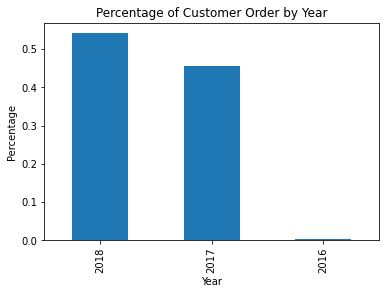

In [51]:
full_df["order_purchase_year"].value_counts(normalize=True).plot.bar()
plt.xlabel("Year")
plt.ylabel("Percentage")
plt.title("Percentage of Customer Order by Year");

## Order Purchase by Month

In [52]:
mask = full_df["order_purchase_month"].value_counts()
mask

8     12632
5     12617
7     12171
3     11725
6     11171
4     11116
2      9984
1      9550
11     9016
12     6565
10     5951
9      5103
Name: order_purchase_month, dtype: int64

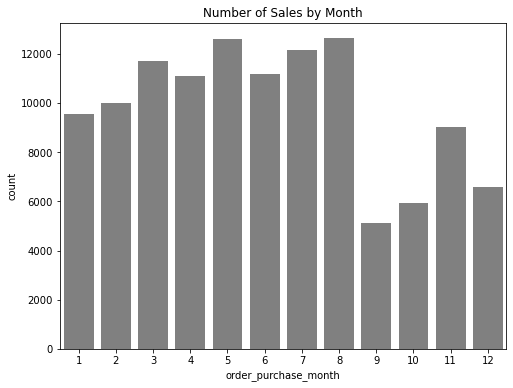

In [53]:
fig, ax = plt.subplots(figsize=(8, 6))
sns.countplot(x="order_purchase_month", data=full_df, color="grey")
plt.title("Number of Sales by Month");

We can see from the above summary that **May and August** have been roughly approximated the month with the highest number of sales in history.

## Order Purchase By Day

In [54]:
full_df["order_purchase_day"].value_counts().head(15)

24    4573
16    4269
15    4140
5     4112
6     4076
18    4052
19    4017
4     4009
7     3984
26    3966
8     3954
14    3936
25    3917
20    3902
13    3880
Name: order_purchase_day, dtype: int64

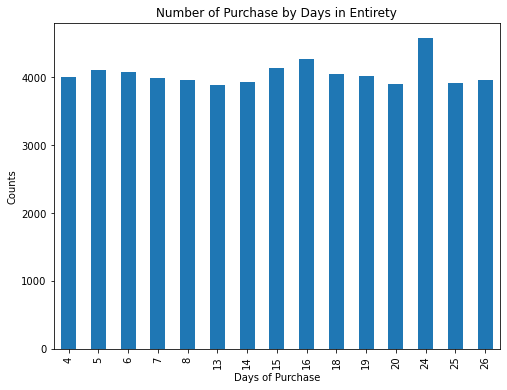

In [55]:
fig, ax = plt.subplots(figsize=(8, 6))
full_df["order_purchase_day"].value_counts().head(15).sort_index().plot.bar()
plt.xlabel("Days of Purchase")
plt.ylabel("Counts")
plt.title("Number of Purchase by Days in Entirety");

We can see from the above summary that in entirety. The day 24 has recorded the highest number of sales in our dataset.

## Order Purchase by Hour

In [56]:
full_df["order_purchase_hour"].value_counts().head(15)

16    7990
14    7896
11    7769
13    7671
15    7612
10    7325
17    7255
21    7249
20    7235
12    7185
19    6983
22    6923
18    6856
9     5644
23    4874
Name: order_purchase_hour, dtype: int64

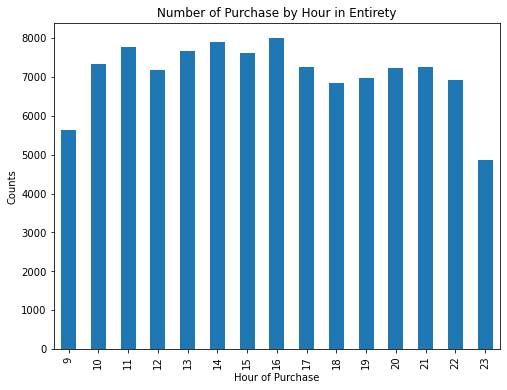

In [57]:
fig, ax = plt.subplots(figsize=(8, 6))
full_df["order_purchase_hour"].value_counts().head(15).sort_index().plot.bar()
plt.xlabel("Hour of Purchase")
plt.ylabel("Counts")
plt.title("Number of Purchase by Hour in Entirety");

We can see that in entirety our most customers do order goods around 4pm. Though we can look at  it on a more scale range which postulates most customers order for goods between 11am to 4pm.

In [58]:
full_df.head().iloc[:, 9:]

,payment_sequential,payment_type,payment_installments,order_item_id,product_id,seller_id,price,product_category_name,order_purchase_year,order_purchase_month,order_purchase_day,order_purchase_hour
0,1,credit_card,2,1,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,124.99,office_furniture,2017,5,16,15
1,1,credit_card,1,1,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,112.99,office_furniture,2017,11,9,0
2,1,credit_card,1,2,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,112.99,office_furniture,2017,11,9,0
3,1,credit_card,7,1,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,124.99,office_furniture,2017,5,7,20
4,1,credit_card,10,1,a9516a079e37a9c9c36b9b78b10169e8,7c67e1448b00f6e969d365cea6b010ab,106.99,office_furniture,2018,2,3,19


## Payment Sequential

In [59]:
full_df["payment_sequential"].value_counts(normalize=True).head(10)

1     0.957118
2     0.028665
3     0.005476
4     0.002653
5     0.001590
6     0.001105
7     0.000757
8     0.000493
9     0.000408
10    0.000340
Name: payment_sequential, dtype: float64

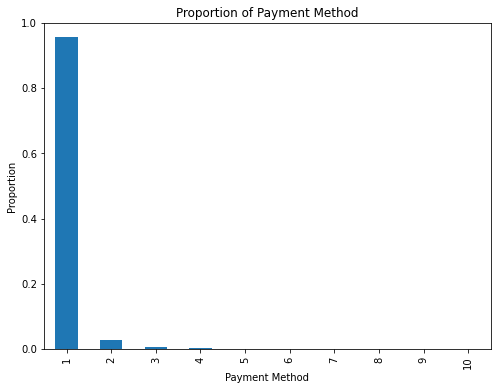

In [60]:
fig = plt.figure()
fig.set_size_inches(8, 6)
full_df["payment_sequential"].value_counts(normalize=True).head(10).plot.bar()
plt.xlabel("Payment Method")
plt.ylabel("Proportion")
plt.ylim(0, 1)
plt.title("Proportion of Payment Method");

From our above summary we see that close to 95% of our customers use 1 payment method (i.e made the payment of their order once using one method) to make their payment. Also close to one percent used 2 payment method, etc.

## Payment Type

In [61]:
full_df["payment_type"].nunique()

4

In [62]:
full_df["payment_type"].value_counts(normalize=True)

credit_card    0.737825
boleto         0.194446
voucher        0.053350
debit_card     0.014379
Name: payment_type, dtype: float64

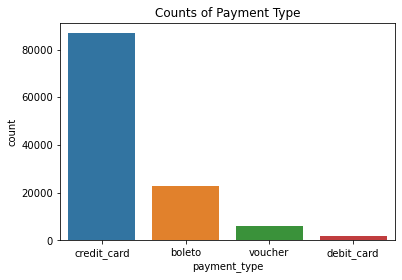

In [63]:
sns.countplot(x = "payment_type", data=full_df)
plt.title("Counts of Payment Type");

We can see from the above summary that:
* Close to 74% of customers make use of credit card for their payment,
* followed by 19% approximately who use boleto payment type, 
* 5 percent who use voucher form of payment type 
* And close to 1 percent make use of their debit card. 

## Payment Installments

Payment Installments: number of installments chosen by the customer.

In [64]:
full_df["payment_installments"].nunique()

24

In [65]:
full_df["payment_installments"].value_counts().head(15).sort_index()

1     58617
2     13722
3     11756
4      7979
5      6017
6      4617
7      1828
8      5063
9       726
10     6845
11       25
12      163
15       92
18       38
24       34
Name: payment_installments, dtype: int64

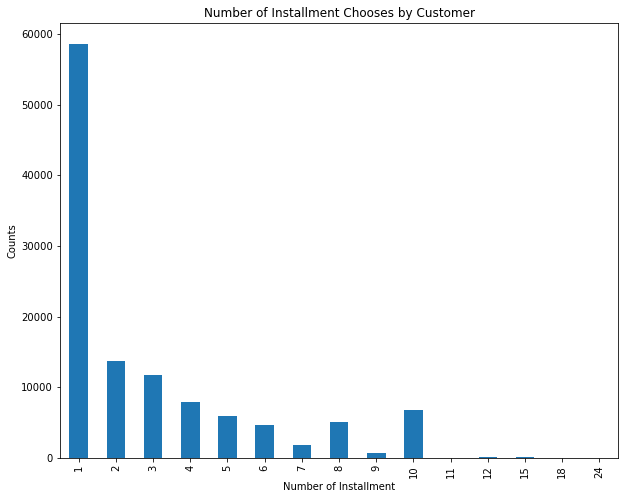

In [66]:
fig = plt.figure()
fig.set_size_inches(10, 8)
full_df["payment_installments"].value_counts().head(15).sort_index().plot.bar()
plt.xlabel("Number of Installment")
plt.ylabel("Counts")
plt.title("Number of Installment Chooses by Customer");

We can see from the above summary that:
* Majority of customers choose to pay for their order once, 
* Followed by customers who choose to pay theirs twice. 
* Also interesting to see customers who choose to pay for their orders 24 times.

## Order Item ID

Order Item ID : sequential number identifying number of items included in the same order.

In [67]:
full_df["order_item_id"].nunique()

21

In [68]:
full_df["order_item_id"].value_counts().head(15)

1     103056
2      10238
3       2375
4        986
5        469
6        262
7         60
8         36
9         28
10        25
11        17
12        13
13         8
14         7
15         5
Name: order_item_id, dtype: int64

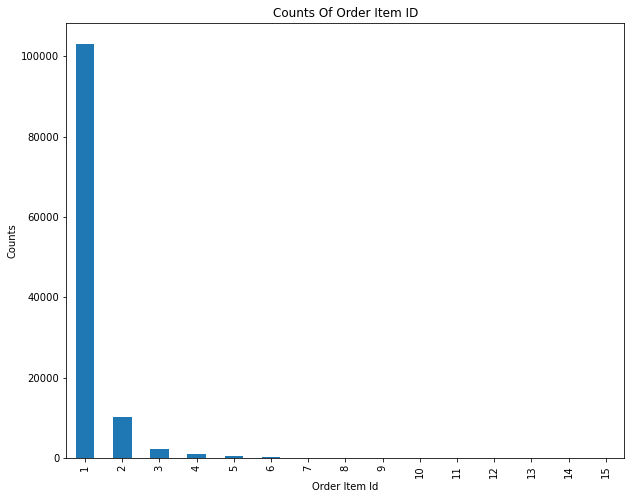

In [69]:
fig = plt.figure()
fig.set_size_inches(10, 8)
full_df["order_item_id"].value_counts().head(15).plot.bar()
plt.xlabel("Order Item Id")
plt.ylabel("Counts")
plt.title("Counts Of Order Item ID");

We can see from the above summary that majority of customers orders one Item per order.

## Product ID

In [70]:
full_df["product_id"].nunique()

32951

From the summary we see that we have 32951 unique products sold to our customers.

## Seller ID

In [71]:
full_df["seller_id"].nunique()

3095

We have 3095 unique sellers that have sold goods to our customers. We won't be needing this feature as well.

## Price

Price : Item Price

In [72]:
fig = px.histogram(
    data_frame=full_df,
    x = "price",
    nbins=100,
    title = "Distribution of the Item Price"
)
fig.show()

## Product Category Name

In [73]:
full_df["product_category_name"].nunique()

73

In [74]:
full_df["product_category_name"].value_counts().head(20)

bed_bath_table              11823
health_beauty                9972
sports_leisure               8945
furniture_decor              8744
computers_accessories        8082
housewares                   7355
watches_gifts                6201
telephony                    4721
garden_tools                 4574
auto                         4379
toys                         4273
cool_stuff                   3987
perfumery                    3560
baby                         3196
electronics                  2845
stationery                   2617
fashion_bags_accessories     2151
pet_shop                     2028
office_furniture             1778
consoles_games               1191
Name: product_category_name, dtype: int64

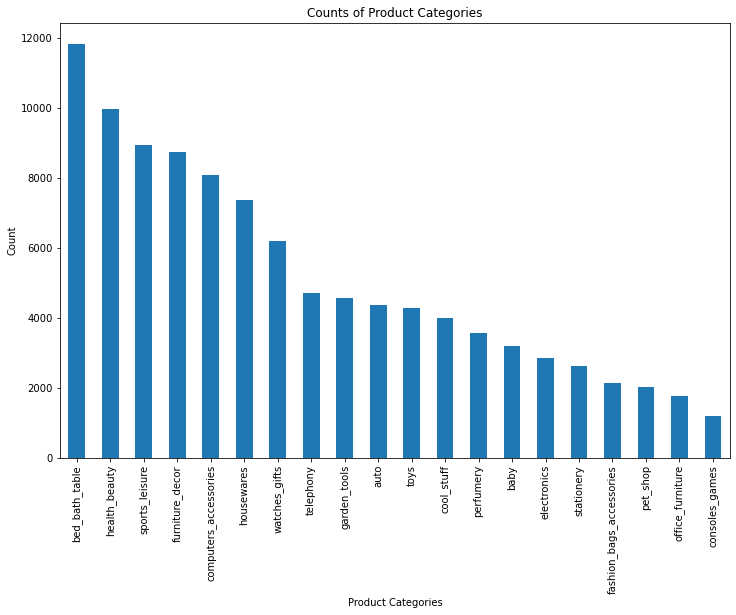

In [75]:
fig = plt.figure()
fig.set_size_inches(12, 8)
full_df["product_category_name"].value_counts().head(20).plot.bar()
plt.xlabel("Product Categories")
plt.ylabel("Count")
plt.title("Counts of Product Categories");

We can see from the above summary the top 20 product categories usually ordered by customers. From the summary we see that the most product ordered by  most customers falls under the bed, bath, and table category which is followed by health beauty.

# Bivariate EDA

In [76]:
full_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 117601 entries, 0 to 117600
Data columns (total 21 columns):
 #   Column                       Non-Null Count   Dtype         
---  ------                       --------------   -----         
 0   customer_id                  117601 non-null  object        
 1   customer_unique_id           117601 non-null  object        
 2   geolocation_zip_code_prefix  117601 non-null  int64         
 3   customer_city                117601 non-null  object        
 4   customer_state               117601 non-null  object        
 5   geolocation_lat              117289 non-null  float64       
 6   geolocation_lng              117289 non-null  float64       
 7   order_id                     117601 non-null  object        
 8   order_purchase_timestamp     117601 non-null  datetime64[ns]
 9   payment_sequential           117601 non-null  int64         
 10  payment_type                 117601 non-null  object        
 11  payment_installments      

## Product Category Name VS Customer State

In [77]:
df = (
    full_df
    .groupby("product_category_name")
    ["customer_state"].value_counts().iloc[::10]
    .rename("frequency")
    .reset_index()

)
head = df.head(68)

In [78]:
fig = px.bar(
    data_frame=head,
    x = "product_category_name",
    y = "frequency",
    color = "customer_state",
    height=800,
)

fig.show()

We can see in the above summary for some product categories that Sau paolo (SP) residents purchases a lot of them. For instance, products such as computer accesories, electronics, bed, bath n table are bought by mostly bought by people from sau paolo.

So in that case if we want to target customers based on a product we should definitely put in consideration their location.

In [79]:
tail = df.tail(69)

In [80]:
fig = px.bar(
    data_frame=tail,
    x = "product_category_name",
    y = "frequency",
    color = "customer_state",
    height=800,
)
fig.show()

Also in terms of products under the sport_leisure category we can see from the above summary that it is usually bought by residents living in MG (Minas Gerals) and so on.

## Payment Type VS Product Category

Let's look at some relationship between Payment Type and Product to see if we can over some patterns from it.

In [81]:
df = (
    full_df
    .groupby("product_category_name")
    ["payment_type"].value_counts().iloc[::10]
    .rename("frequency")
    .reset_index()

)
df

,product_category_name,payment_type,frequency
0,agro_industry_and_commerce,credit_card,145
1,art,voucher,13
2,auto,boleto,840
3,bed_bath_table,debit_card,142
4,books_technical,debit_card,5
5,cine_photo,debit_card,3
6,consoles_games,boleto,243
7,construction_tools_lights,voucher,12
8,costruction_tools_garden,boleto,46
9,drinks,boleto,65


In [82]:
fig = px.bar(
    data_frame=df,
    x = "product_category_name",
    y = "frequency",
    color = "payment_type",
    height=800,
)
fig.show()

There are some trends concerning payment type and the product. As we can see that there are precisement as to the payment type used for some product category.

## Order Purchase Year VS Order Purchase Month

In [83]:
df_mask =(full_df
    .groupby("order_purchase_year")
    ["order_purchase_month"].value_counts()
    .rename("Frequency")
    .reset_index()

)

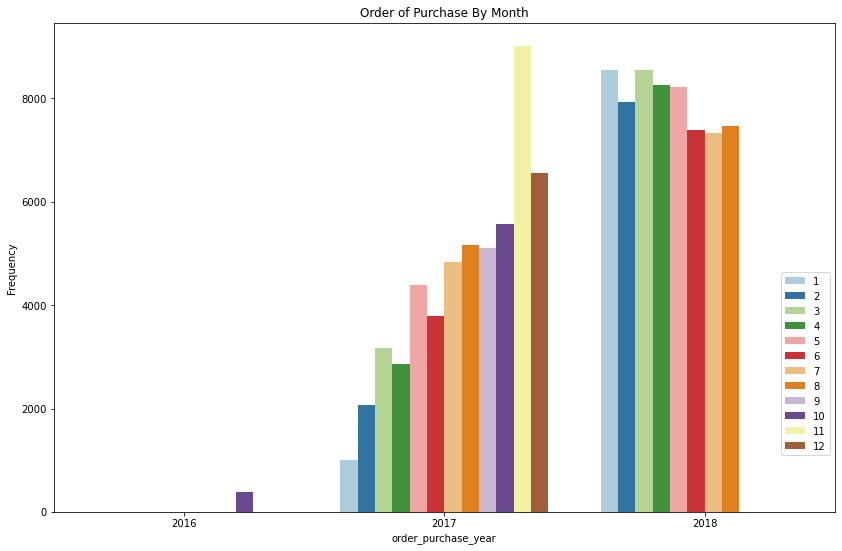

In [84]:
fig, ax = plt.subplots(figsize = (14, 9))
sns.color_palette("tab10")
sns.barplot(x = "order_purchase_year",
            y = "Frequency", data=df_mask,
            hue="order_purchase_month",
            palette="Paired")
plt.title("Order of Purchase By Month")
plt.gca().legend(loc='upper right', bbox_to_anchor=(1, 0.5));

We obtain the following summary from this visualization
* In 2016 sales where only made in October (which is mark as 10 in seaborn legend).
* In 2017 The minimum number of sales occured in January and November recorded the highest number of sales.
* In 2018 January and March roughly had the same highest number of sales and August was the minimum.

In [85]:
full_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 117601 entries, 0 to 117600
Data columns (total 21 columns):
 #   Column                       Non-Null Count   Dtype         
---  ------                       --------------   -----         
 0   customer_id                  117601 non-null  object        
 1   customer_unique_id           117601 non-null  object        
 2   geolocation_zip_code_prefix  117601 non-null  int64         
 3   customer_city                117601 non-null  object        
 4   customer_state               117601 non-null  object        
 5   geolocation_lat              117289 non-null  float64       
 6   geolocation_lng              117289 non-null  float64       
 7   order_id                     117601 non-null  object        
 8   order_purchase_timestamp     117601 non-null  datetime64[ns]
 9   payment_sequential           117601 non-null  int64         
 10  payment_type                 117601 non-null  object        
 11  payment_installments      

# Modelling

dropping some features that won't be useful.

In [86]:
full_df.drop(columns = ["customer_id", "customer_unique_id", "customer_city",
                        "order_id", "order_purchase_timestamp", "seller_id", "product_id"], inplace=True)

In [87]:
full_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 117601 entries, 0 to 117600
Data columns (total 14 columns):
 #   Column                       Non-Null Count   Dtype  
---  ------                       --------------   -----  
 0   geolocation_zip_code_prefix  117601 non-null  int64  
 1   customer_state               117601 non-null  object 
 2   geolocation_lat              117289 non-null  float64
 3   geolocation_lng              117289 non-null  float64
 4   payment_sequential           117601 non-null  int64  
 5   payment_type                 117601 non-null  object 
 6   payment_installments         117601 non-null  int64  
 7   order_item_id                117601 non-null  int64  
 8   price                        117601 non-null  float64
 9   product_category_name        115903 non-null  object 
 10  order_purchase_year          117601 non-null  int64  
 11  order_purchase_month         117601 non-null  int64  
 12  order_purchase_day           117601 non-null  int64  
 13 

So we want to build a clustering model based on this features.

In [88]:
full_df.head()

,geolocation_zip_code_prefix,customer_state,geolocation_lat,geolocation_lng,payment_sequential,payment_type,payment_installments,order_item_id,price,product_category_name,order_purchase_year,order_purchase_month,order_purchase_day,order_purchase_hour
0,14409,SP,-20.509897,-47.397866,1,credit_card,2,1,124.99,office_furniture,2017,5,16,15
1,68030,PA,-2.442747,-54.728950,1,credit_card,1,1,112.99,office_furniture,2017,11,9,0
2,68030,PA,-2.442747,-54.728950,1,credit_card,1,2,112.99,office_furniture,2017,11,9,0
3,92480,RS,-29.856534,-51.268958,1,credit_card,7,1,124.99,office_furniture,2017,5,7,20
4,25931,RJ,-22.627556,-43.159942,1,credit_card,10,1,106.99,office_furniture,2018,2,3,19


In [89]:
#from sklearn.cluster import KMeans
#from sklearn.decomposition import PCA
#from sklearn.metrics import silhouette_score
#from sklearn.preprocessing import StandardScaler
from category_encoders import OrdinalEncoder
from sklearn.pipeline import make_pipeline

In [90]:
cat_features = full_df.select_dtypes("O").columns.tolist()

In [91]:
ord_enc = OrdinalEncoder(cols = cat_features)
transformed_df = ord_enc.fit_transform(full_df)

### Dropping Missing Values

In [92]:
transformed_df.dropna(axis=0, inplace=True)

# Build Clusters Based On Location and Product Category

In [93]:
X = transformed_df[["customer_state", "product_category_name"]]

In [94]:
from kmodes.kmodes import KModes

Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 1, iteration: 1/100, moves: 0, cost: 173234.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 2, iteration: 1/100, moves: 0, cost: 173234.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 3, iteration: 1/100, moves: 0, cost: 173234.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 4, iteration: 1/100, moves: 0, cost: 173234.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 5, iteration: 1/100, moves: 0, cost: 173234.0
Best run was number 1
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 1, iteration: 1/100, moves: 0, cost: 157920.0
Init: initializing centroids
Init: initializing clusters
Starting iterations...
Run 2, iteration: 1/100, moves: 0, cost: 170396.0
Init: initializing centroids
Init: initializing clusters
Starting it

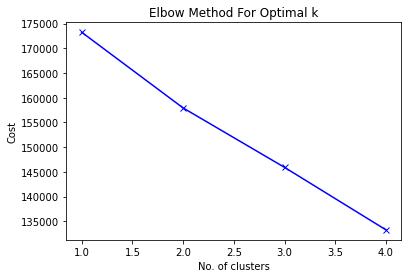

In [95]:
cost = []
clusters = range(1, 5)
for k in clusters:
    model = KModes(n_clusters=k, init = "random", n_init = 5, verbose=1)
    model.fit_predict(X)
    cost.append(model.cost_)

    
plt.plot(clusters, cost, 'bx-')
plt.xlabel('No. of clusters')
plt.ylabel('Cost')
plt.title('Elbow Method For Optimal k')
plt.show()